# PBMC Type Prediction using Label Free Channels

# Package imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# %load common_.py
from common import *

In [3]:
import fcsparser
from ehv import feature_comparison, core
import flowutils
import shap
shap.initjs()

In [4]:
import sklearn.base
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import normalize, scale, minmax_scale, LabelEncoder, StandardScaler
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.feature_selection import VarianceThreshold
from sklearn import tree
from sklearn.pipeline import make_pipeline
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, cross_validate
from sklearn.preprocessing import LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from sklearn.svm import SVC
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV

In [5]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler, ADASYN, SMOTE
from imblearn.pipeline import make_pipeline as imb_make_pipeline

In [6]:
from multiprocessing import Pool
from scipy.stats import spearmanr
import pickle
import hiplot

# Data import

Feature values from SCIP and IDEAS are imported. In total we import 133354 features.

In [11]:
data_dir = Path(os.environ["HOME"]) / "scratch/data/vsc/wbc/results/scip/202204271347/"

In [7]:
data_dir = Path(os.environ["VSC_DATA_VO_USER"]) / "datasets/wbc/results/scip/202204271347/"

In [8]:
df_scip = pq.read_table(data_dir / "features.parquet").to_pandas()

cat_type = CategoricalDtype(
    categories=sorted(df_scip["meta_group"].astype(int).unique()), ordered=True)
df_scip["meta_group"] = df_scip["meta_group"].astype(int).astype(cat_type)

cat_type = CategoricalDtype(
    categories=sorted(df_scip["meta_part"].astype(int).unique()), ordered=True)
df_scip["meta_part"] = df_scip["meta_part"].astype(int).astype(cat_type)

df_scip = df_scip.set_index(["meta_group", "meta_part", "meta_fix", "meta_object_number"])

df_scip = df_scip[numpy.load(
    data_dir / "indices/columns.npy", allow_pickle=True)]
df_scip = df_scip.loc[numpy.load(
    data_dir / "indices/index.npy", allow_pickle=True)]

df_scip["meta_label"] = pandas.Categorical(df_scip["meta_label"], ordered=True)

df_scip.shape

(233262, 2200)

In [18]:
df_scip["meta_label"].value_counts()

CD15 + Neutrophils    139710
CD4 T cells            34460
CD8 T cell             15009
unknown                14632
CD19 pos B cells        9035
CD56+ NK Cells          6798
CD14+ Monocyte          4800
NK T cells              4727
Eosinophils             4091
Name: meta_label, dtype: int64

In [53]:
glcms = set(df_scip.filter(regex=".*glcm.*(BF1|BF2|SSC)$").columns)
combined_glcms = set(df_scip.filter(regex=".*combined.*glcm.*(BF1|BF2|SSC)$").columns)
noncomb_glcms = glcms - combined_glcms
df_scip = df_scip.drop(columns=noncomb_glcms)
df_scip.shape

(247993, 2447)

In [19]:
df = df_scip

## IDEAS

In [54]:
# ideas features
def proc_cols(cols):
    out = []
    for col in cols:
        col = col.lower()
        for c in [" ", "-", "_", "."]:
            col = col.replace(c, "")
        out.append(col)
    return out

tmp = []
cols = None
for p in (data_dir / "results/ideas/202111121025").glob('*.fcs'):
    meta, data = fcsparser.parse(p)
    groups = re.search("wbc(?P<group>[0-9])_(?P<part>[0-9])_?(?P<fix>(early|late))?.fcs", p.name).groupdict()
    data["fix"] = groups["fix"]
    data["group"] = int(groups["group"])
    data["part"] = int(groups["part"])
    data.columns = proc_cols(data.columns)
    if cols is None:
        cols = data.columns  
    tmp.append(data[cols])
df_ideas = pandas.concat(tmp, axis=0)

r = r"(?i).*(uncompensated|bkgd|saturation|\().*" 
todrop = list(filter(lambda x: re.match(r, x), df_ideas.columns))
df_ideas = df_ideas.drop(columns=todrop)

ideas_meta_cols = ["objectnumber", "fix", "group", "part"]
df_ideas = df_ideas.rename(columns=lambda col: f"meta_{col.lower()}" if col in ideas_meta_cols else f"feat_{col.lower()}")

df_ideas["meta_object_number"] = df_ideas["meta_objectnumber"].astype(int)
df_ideas = df_ideas.drop(columns="meta_objectnumber")

df_ideas.shape

(274050, 309)

In [55]:
df_scip = df_scip.set_index(["meta_object_number", "meta_part", "meta_group", "meta_fix"])
df_ideas = df_ideas.set_index(["meta_object_number", "meta_part", "meta_group", "meta_fix"])

In [56]:
df = df_scip.rename(columns=lambda a: "scip_"+a).join(
    df_ideas.rename(columns=lambda a: "ideas_"+a),  
    how="inner", lsuffix="ideas", rsuffix="scip"
)
df.shape

(247993, 2748)

In [57]:
def rename(c):
    if c.startswith("scip_meta"):
        return "meta_" + c[10:]
    return c
df = df.rename(columns=rename)

In [58]:
df["meta_label"].unique()

array(['Eosinophils', 'CD15 + Neutrophils', 'CD4 T cells', 'unknown',
       'NK T cells', 'CD8 T cell', 'CD56+ NK Cells', 'CD14+ Monocyte',
       'CD19 pos B cells'], dtype=object)

# Continue with events assigned to cell states

I filter out the events falling between manual gates. This is only a small amount of events

In [22]:
df = df.loc[df["meta_label"] != "unknown"].copy()
df.shape

(218630, 2200)

In [23]:
df["meta_label"] = df["meta_label"].astype("category")

# Feature comparison between IDEAS and SCIP

I compare the intensity features computed in SCIP and IDEAS in order to assess the quality of the SCIP features. I expect that they are highly correlated.

## BF intensity

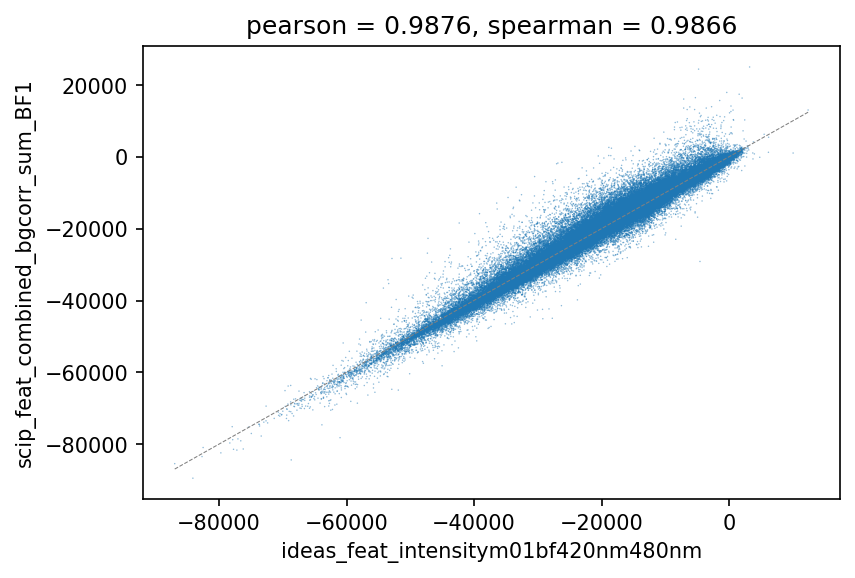

In [62]:
feature_comparison.compare_features(df, "ideas_feat_intensitym01bf420nm480nm", "scip_feat_combined_bgcorr_sum_BF1")

# Predicting IDEAS manual gates from all fluorescence intensity features

This is a baseline _sanity check_. Classification metrics should all be very high, since the manual gates have been set on the fluorescence intensity features using relatively simple rules (bisections or circular gates).

In [63]:
def predict_gates(X, y, model, seed=42):
    numpy.random.seed(seed)
    
    scoring = ('balanced_accuracy', 'f1_macro', 'f1_micro', 'precision_macro', 'precision_micro', 'recall_macro', 'recall_micro')
    cv_results = cross_validate(
        estimator=model,
        X=X.values, y=y, cv=5,
        scoring=scoring,
        return_train_score=True,
        return_estimator=True,
        n_jobs=5,
        verbose=0
    )
    cv_df = pandas.DataFrame(
        data = {
            **{"phase": ["train"] * 5 + ["test"] * 5},
            **{k: numpy.concatenate([cv_results[f"train_{k}"], cv_results[f"test_{k}"]]) for k in scoring}
        }
    ).melt(id_vars=["phase"])
    seaborn.stripplot(data=cv_df, y="variable", x="value", hue="phase", jitter=0)
    return cv_df

In [25]:
enc = LabelEncoder().fit(df["meta_label"])
y = enc.transform(df["meta_label"])

Class imabalance is quite high. This should be taken into account later on.

<AxesSubplot:xlabel='count', ylabel='meta_label'>

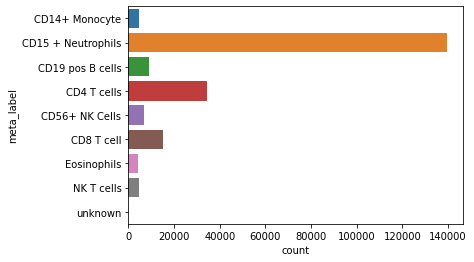

In [26]:
seaborn.countplot(y=df["meta_label"])

The below plots show the cross-validation results for a decision tree classifier trained to classify the infection states. Each dot corresponds to a random split of the data in training and testing data. The orange dots show each metric computed on the test data. As expected, all metrics are very high.

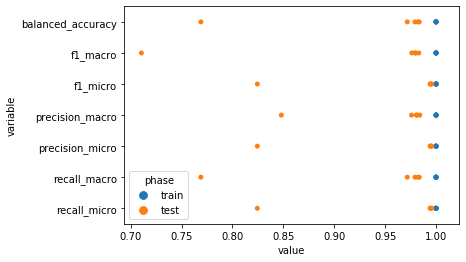

In [66]:
model = tree.DecisionTreeClassifier(class_weight="balanced")
_ = predict_gates(
    df.filter(regex="scip_feat_combined_bgcorr.*sum.*"), y, 
    model
)

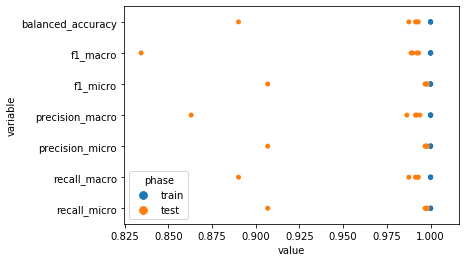

In [67]:
model = tree.DecisionTreeClassifier(class_weight="balanced")
_ = predict_gates(
    df.filter(regex="ideas_feat_intensitym.*"), y, 
    model
)

# Quality control plots of fluorescence channels control and infected samples

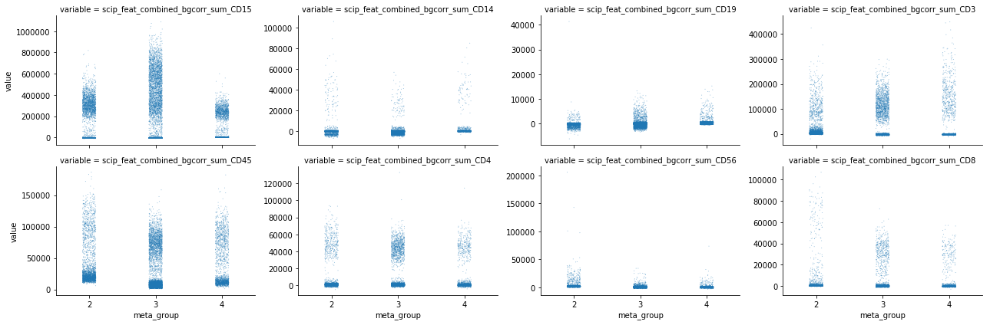

In [68]:
# SCIP features

melted_df = pandas.melt(df.reset_index().sample(n=10000), id_vars=["meta_part", "meta_group", "meta_fix"], value_vars=df.filter(regex="scip_feat_combined_bgcorr_sum_CD.*").columns)
grid = seaborn.FacetGrid(data=melted_df, col="variable", sharey=False, aspect=1.5, col_wrap=4)
grid.map_dataframe(seaborn.stripplot, x="meta_group", y="value", dodge=True, size=1, alpha=0.5)
grid.add_legend()

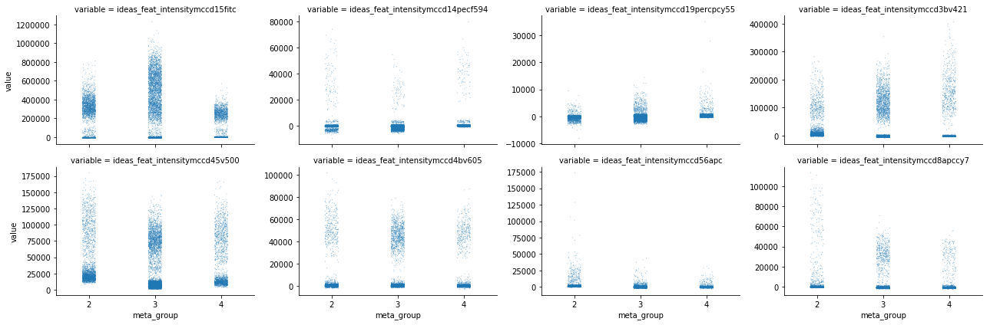

In [69]:
# IDEAS features

melted_df = pandas.melt(df.reset_index().sample(n=10000), id_vars=["meta_part", "meta_group", "meta_fix"], value_vars=df.filter(regex="ideas_feat_intensitymc.*cd.*").columns)
grid = seaborn.FacetGrid(data=melted_df, col="variable", col_wrap=4, sharey=False, aspect=1.5)
grid.map_dataframe(seaborn.stripplot, x="meta_group", y="value", dodge=True, size=1, alpha=0.5)
grid.add_legend()

# Predicting cell types based on label-free channels


In [28]:
# selection of the generic channel features for SCIP
to_keep = df.filter(regex=".*scip.*(BF1|BF2|SSC)$").columns
Xs = df[to_keep]
Xs.shape

Xs_train, Xs_test, y_train, y_test = train_test_split(Xs, y, stratify=y, test_size=0.2, random_state=0)

In [29]:
# selection of the generic channel features for IDEAS
to_keep_i = df.filter(regex=".*ideas.*(m01|m09|bf|m06|ssc).*").columns
Xi = df[to_keep_i]
Xi.shape

Xi_train, Xi_test = train_test_split(Xi, stratify=y, test_size=0.2, random_state=0)

In [30]:
df_train, df_test = train_test_split(df, stratify=y, test_size=0.2, random_state=0)

In [73]:
print(Xs_train.isna().any(axis=1).sum())

bool_idx = ~Xs_train.isna().any(axis=1).values
Xs_train = Xs_train[bool_idx]
Xi_train = Xi_train[bool_idx]
df_train = df_train[bool_idx]
y_train = y_train[bool_idx]

698


In [74]:
print(Xs_test.isna().any(axis=1).sum())

bool_idx = ~Xs_test.isna().any(axis=1).values
Xs_test = Xs_test[bool_idx]
Xi_test = Xi_test[bool_idx]
df_test = df_test[bool_idx]
y_test = y_test[bool_idx]

284


## Classification using a support vector machine

First, I use a support vector machine (SVM) for classifying the infection states. This model performs well, but it has the downside of not being interpretable. We can not derive any new insights on what features the model uses for its prediction. I still want to test this model since it gives us a baseline performance value to compare to when I test a more interpretable model later on. To deal with the class imbalance, the class_weight parameter is set to balanced. This will cause the model to be penalized more when it makes a wrong prediction for the minority classes (= all classes except for the MCP-/PSBA+ state.

In [53]:
model_svc = imb_make_pipeline(
    RandomUnderSampler(sampling_strategy="not minority", random_state=0),
    StandardScaler(),
    SVC(cache_size=4096)
)

### Tuning C

Here I tune a hyperparameter of the SVM model.

In [54]:
%%time
scoring = ('balanced_accuracy', 'f1_macro', 'f1_micro', 'precision_macro', 'precision_micro', 'recall_macro', 'recall_micro')
grid = GridSearchCV(
    model_svc,
    {
        "svc__C": [0.1, 0.5, 1, 1.5, 2, 2.5]
    },
    refit=False,
    n_jobs=30,
    cv=5,
    scoring=scoring,
    verbose=1,
    return_train_score=True
).fit(
    numpy.ascontiguousarray(Xs_train.values),
    y_train
)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.


TerminatedWorkerError: A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.

The exit codes of the workers are {SIGKILL(-9)}

AttributeError: 'FacetGrid' object has no attribute 'cv_results_'

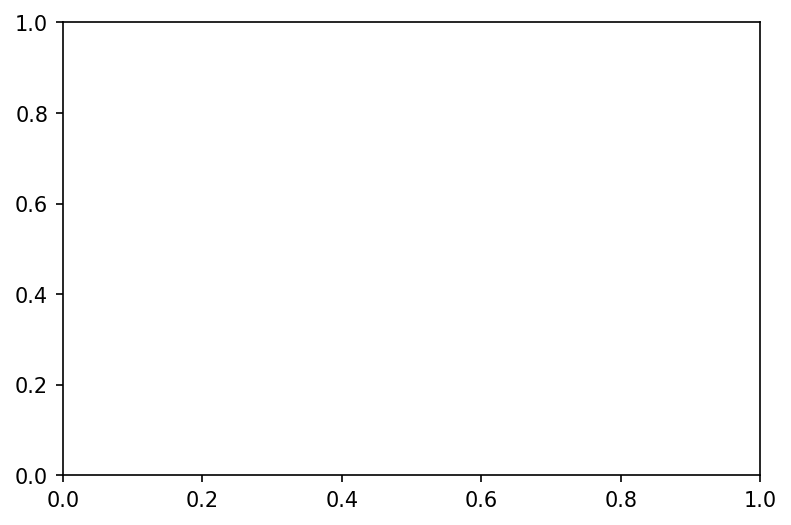

In [55]:
fig, ax = plt.subplots(dpi=150)
ax.errorbar(grid.cv_results_["param_svc__C"], grid.cv_results_["mean_test_balanced_accuracy"], yerr=grid.cv_results_["std_test_balanced_accuracy"], label="test")
ax.errorbar(grid.cv_results_["param_svc__C"], grid.cv_results_["mean_train_balanced_accuracy"], yerr=grid.cv_results_["std_train_balanced_accuracy"], label="train")

### Prediction of cell types

I fit the SVM on both IDEAS and SCIP features for comparison.

First on IDEAS features.

In [60]:
%%time
model_svc_i = model_svc.fit(Xi_train, y_train)

CPU times: user 38.8 s, sys: 429 ms, total: 39.2 s
Wall time: 39.5 s


In [61]:
%%time
preds_i = model_svc_i.predict(Xi_test)
balanced_accuracy_score(y_test, preds_i)

CPU times: user 4min 57s, sys: 10.8 ms, total: 4min 57s
Wall time: 4min 58s


0.7402223360180239

The balanced accuracy has a fairly good value. The confusion matrix below gives us more insight into where the model struggles. In the confusion matrix we want to see ideally a high value on the diagonal. On the diagonal the events are counted for which the prediction of the model agrees with the actual ground truth label. Off-diagonal counts indicate wrong predictions by the model, this indicates the model's _confusion_. Note that the matrix is normalized per row.

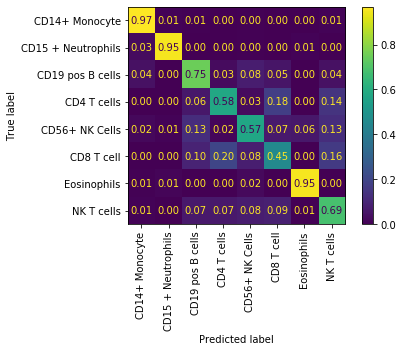

In [70]:
ConfusionMatrixDisplay.from_predictions(y_test, preds_i, display_labels=enc.classes_, normalize='true', xticks_rotation="vertical", values_format=".2f")

In [63]:
%%time
model_svc_s = model_svc.fit(Xs_train, y_train)

CPU times: user 1min 31s, sys: 433 ms, total: 1min 32s
Wall time: 1min 32s


In [67]:
%%time
preds_s = model_svc_s.predict(Xs_test)
balanced_accuracy_score(y_test, preds_s)

0.7545157650611263

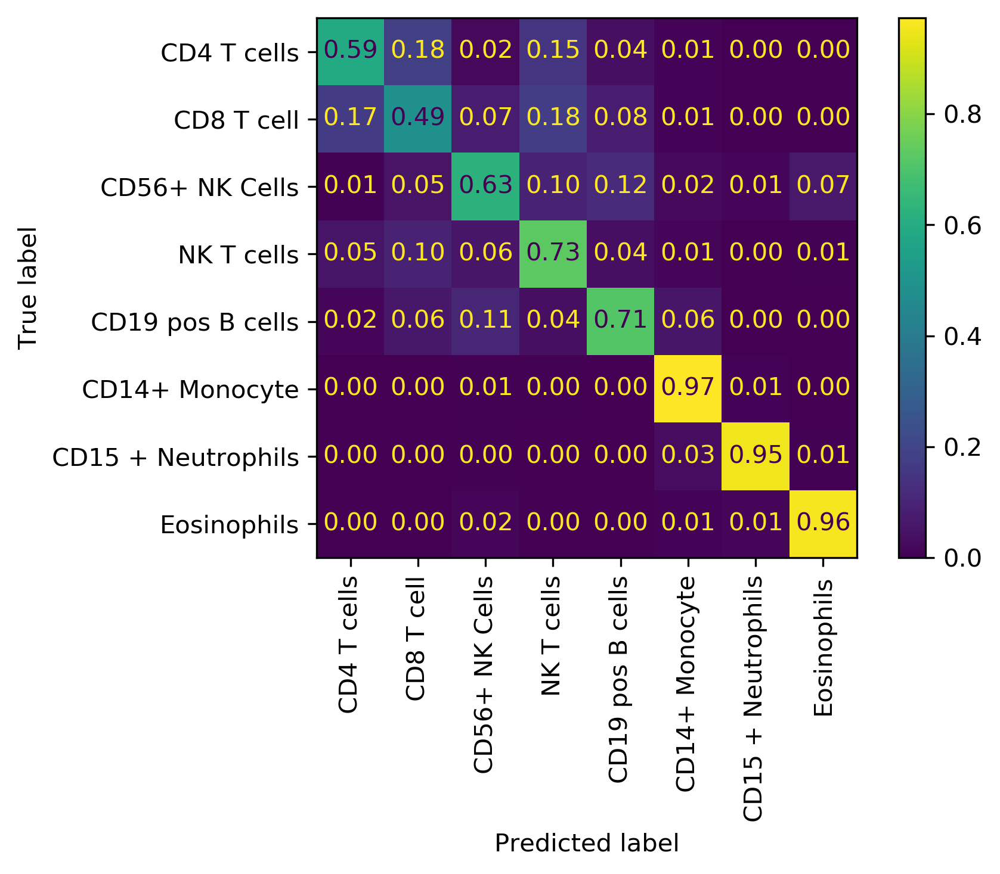

In [80]:
fig, ax = plt.subplots(dpi=300)
ConfusionMatrixDisplay.from_predictions(
    y_test, preds_s,
    labels=[3, 5, 4, 7, 2, 0, 1, 6],
    display_labels=enc.classes_[[3, 5, 4, 7, 2, 0, 1, 6]],
    normalize='true', xticks_rotation="vertical", values_format=".2f",
    ax=ax
)

## Classification and feature analysis using an Extreme Gradient Boosting classifier

The Extreme Gradient Boosting (XGB) classifier is also powerful model, which uses a collection of decision trees to predict the infection states. The advantage of decision trees is that they are interpretable. If I can achieve similar performance with the XGB classifier as with an SVM, we will have a decently performing and interpretable model that can give us insight into which features of the generic channels correlate with the TMR and Cy5 channels.

### Fitting XGBClassifier

Here, I fit an XGB classifier with 1000 decision trees. It reaches a balanced accuracy score of 0.76 which is reasonably close to the SVM's 0.77. Comparing the confusion matrices, we can see that the XGB classifier is struggling a bit more with MCP-/PSBA- classses than the SVM. As with the SVM, I tried to alleviate class imbalance by weighting the classes. This did not improve performance for this model.

### Tuning hyper parameters

Here I tune the learning rate hyperparameter of the XGB model.

In [13]:
with open(data_dir / f"rsh/grid.pickle", "rb") as fh:
    grid = pickle.load(fh)

Trying to unpickle estimator HalvingRandomSearchCV from version 1.0.1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations


In [14]:
results = pandas.DataFrame(grid.cv_results_)
results["params_str"] = results.params.apply(lambda foo: str({k:v for k,v in foo.items()}))

In [15]:
results.drop_duplicates(subset=("params_str", "iter"), inplace=True)
mean_scores = results.pivot(
    index="iter", columns="params_str", values="mean_test_score"
)

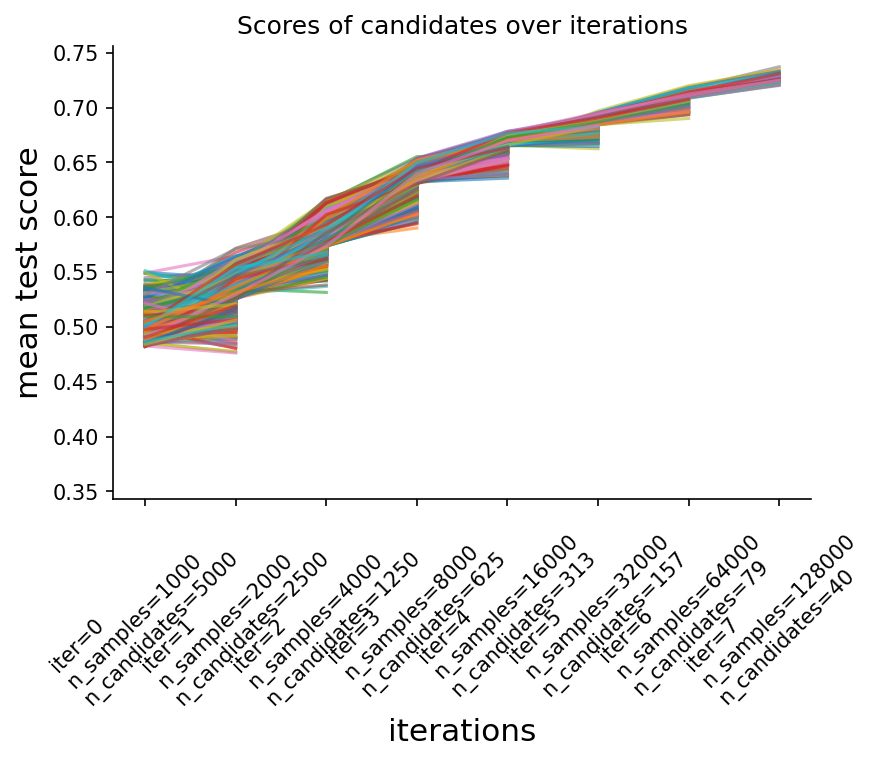

In [16]:
fig, ax = plt.subplots(dpi=150)
mean_scores.plot(legend=False, alpha=0.6, ax=ax)

labels = [
    f"iter={i}\nn_samples={grid.n_resources_[i]}\nn_candidates={grid.n_candidates_[i]}"
    for i in range(grid.n_iterations_)
]

ax.set_xticks(range(grid.n_iterations_))
ax.set_xticklabels(labels, rotation=45, multialignment="left")
ax.set_title("Scores of candidates over iterations")
ax.set_ylabel("mean test score", fontsize=15)
ax.set_xlabel("iterations", fontsize=15)
seaborn.despine(fig)

In [17]:
df = pandas.DataFrame(grid.cv_results_["params"])
df["mean_test_balanced_accuracy"] = grid.cv_results_["mean_test_score"]
df["mean_train_balanced_accuracy"] = grid.cv_results_["mean_train_score"]
df["std_test_balanced_accuracy"] = grid.cv_results_["std_test_score"]
df["std_train_balanced_accuracy"] = grid.cv_results_["std_train_score"]

In [18]:
hiplot.Experiment.from_iterable(df.to_dict(orient="records")).display()

<IPython.core.display.Javascript object>

In [83]:
with open(data_dir / f"rsh/grid2.pickle", "rb") as fh:
    grid = pickle.load(fh)

Trying to unpickle estimator HalvingRandomSearchCV from version 1.0.1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations


In [84]:
results = pandas.DataFrame(grid.cv_results_)
results["params_str"] = results.params.apply(lambda foo: str({k:v for k,v in foo.items() if k!="xgbclassifier__n_estimators"}))

In [85]:
results.drop_duplicates(subset=("params_str", "iter"), inplace=True)
mean_scores = results.pivot(
    index="iter", columns="params_str", values="mean_test_score"
)

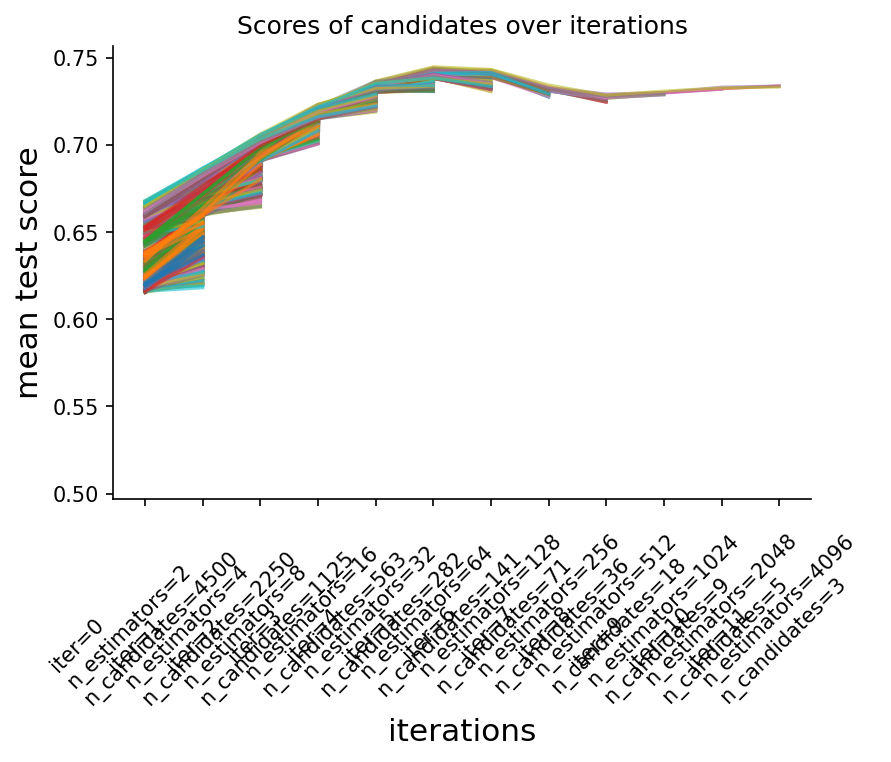

In [88]:
fig, ax = plt.subplots(dpi=150)
mean_scores.plot(legend=False, alpha=0.6, ax=ax)

labels = [
    f"iter={i}\nn_estimators={grid.n_resources_[i]}\nn_candidates={grid.n_candidates_[i]}"
    for i in range(grid.n_iterations_)
]

ax.set_xticks(range(grid.n_iterations_))
ax.set_xticklabels(labels, rotation=45, multialignment="left")
ax.set_title("Scores of candidates over iterations")
ax.set_ylabel("mean test score", fontsize=15)
ax.set_xlabel("iterations", fontsize=15)
seaborn.despine(fig)

In [89]:
df = pandas.DataFrame(grid.cv_results_["params"])
df["mean_test_balanced_accuracy"] = grid.cv_results_["mean_test_score"]
df["mean_train_balanced_accuracy"] = grid.cv_results_["mean_train_score"]
df["std_test_balanced_accuracy"] = grid.cv_results_["std_test_score"]
df["std_train_balanced_accuracy"] = grid.cv_results_["std_train_score"]

In [90]:
hiplot.Experiment.from_iterable(df.to_dict(orient="records")).display()

<IPython.core.display.Javascript object>

In [9]:
with open(data_dir / f"rsh/grid_n_estimators_onlyover.pickle", "rb") as fh:
    grid = pickle.load(fh)

Trying to unpickle estimator HalvingRandomSearchCV from version 1.0.1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations


In [10]:
results = pandas.DataFrame(grid.cv_results_)
results["params_str"] = results.params.apply(lambda foo: str({k:v for k,v in foo.items() if k!="xgbclassifier__n_estimators"}))

In [11]:
results.drop_duplicates(subset=("params_str", "iter"), inplace=True)
mean_scores = results.pivot(
    index="iter", columns="params_str", values="mean_test_score"
)

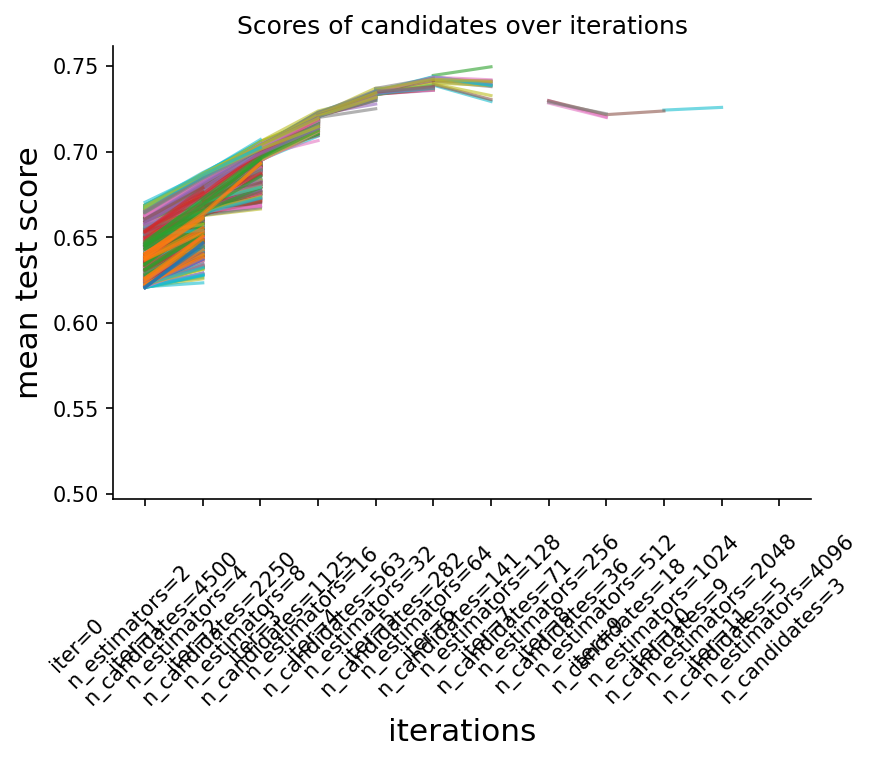

In [12]:
fig, ax = plt.subplots(dpi=150)
mean_scores.plot(legend=False, alpha=0.6, ax=ax)

labels = [
    f"iter={i}\nn_estimators={grid.n_resources_[i]}\nn_candidates={grid.n_candidates_[i]}"
    for i in range(grid.n_iterations_)
]

ax.set_xticks(range(grid.n_iterations_))
ax.set_xticklabels(labels, rotation=45, multialignment="left")
ax.set_title("Scores of candidates over iterations")
ax.set_ylabel("mean test score", fontsize=15)
ax.set_xlabel("iterations", fontsize=15)
seaborn.despine(fig)

In [89]:
df = pandas.DataFrame(grid.cv_results_["params"])
df["mean_test_balanced_accuracy"] = grid.cv_results_["mean_test_score"]
df["mean_train_balanced_accuracy"] = grid.cv_results_["mean_train_score"]
df["std_test_balanced_accuracy"] = grid.cv_results_["std_test_score"]
df["std_train_balanced_accuracy"] = grid.cv_results_["std_train_score"]

In [90]:
hiplot.Experiment.from_iterable(df.to_dict(orient="records")).display()

<IPython.core.display.Javascript object>

In [82]:
model_xgb = imb_make_pipeline(
    RandomOverSampler(sampling_strategy="not majority", random_state=0),
    XGBClassifier(
        booster="gbtree",  
        objective="multi:softmax", 
        eval_metric="merror",
        tree_method="gpu_hist",
        use_label_encoder=False,
        subsample=1,
        n_estimators=64,
        learning_rate=0.3,
        max_depth=6,
        colsample_bytree=0.9
    )
)

In [94]:
model_xgb_s = sklearn.base.clone(model_xgb).fit(Xs_train, y_train)

In [95]:
preds = model_xgb_s.predict(Xs_train)
balanced_accuracy_score(y_train, preds)

0.9122183540170098

In [96]:
preds = model_xgb_s.predict(Xs_test)
balanced_accuracy_score(y_test, preds)

0.8168300147414236

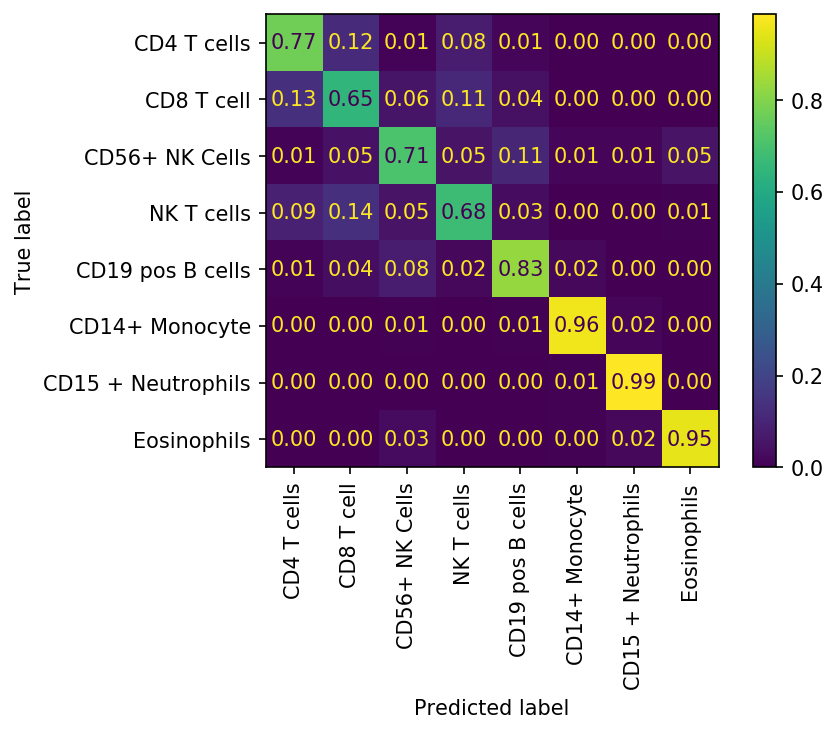

In [117]:
fig, ax = plt.subplots(dpi=150)
ConfusionMatrixDisplay.from_predictions(
    y_test, preds, 
    labels=[3, 5, 4, 7, 2, 0, 1, 6],
    display_labels=enc.classes_[[3, 5, 4, 7, 2, 0, 1, 6]],
    normalize='true', xticks_rotation="vertical", values_format=".2f",
    ax=ax
)
plt.savefig("xgb_pbmc_confmat.png", bbox_inches="tight")

In [122]:
incorrect = df_test[y_test != preds]

In [124]:
incorrect["meta_sample"].value_counts()

wbc4_1_late     784
wbc4_1_early    731
wbc2_3          683
wbc2_2          658
wbc3_3_late     631
wbc2_1          609
wbc3_2_late     582
wbc3_1_late     577
wbc3_2_early    427
wbc3_3_early    422
wbc3_1_early    401
Name: meta_sample, dtype: int64

In [126]:
incorrect.index.to_frame()["meta_group"].value_counts()

3    3040
2    1950
4    1515
Name: meta_group, dtype: int64

In [127]:
incorrect.index.to_frame()["meta_fix"].value_counts()

late     2574
early    1981
Name: meta_fix, dtype: int64

In [87]:
model_xgb_i = sklearn.base.clone(model_xgb).fit(Xi_train, y_train)

In [88]:
preds = model_xgb_i.predict(Xi_train)
balanced_accuracy_score(y_train, preds)

0.8999585650793811

In [89]:
preds = model_xgb_i.predict(Xi_test)
balanced_accuracy_score(y_test, preds)

0.8141440112922558

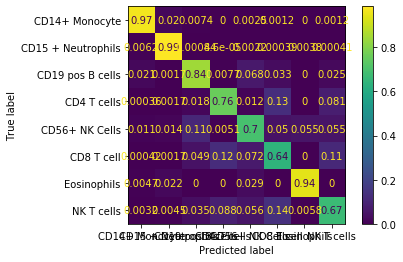

In [90]:
ConfusionMatrixDisplay.from_predictions(y_test, preds, display_labels=enc.classes_, normalize='true')

### Interpreting the Extreme Gradient Boosting classifier

#### Feature importances of the decision trees

One way of interpreting the model is by looking at the features importances. Decision tree-based classifiers are constructed by iteratively splitting up the dataset based on an optimal value of a specific feature. This process continues until pure _leaves_ are obtained which contain only instances from one class. Througout the training process the algorithm records how many times a feature is used for splitting the set. A feature that is used often will have a high importance score.

In the table below, we can see the top 10 most important features used by the XGB model to predict the infection state based on the BF1, SSC and DAPI signals. We can see that these are mainly DAPI features. This is already an interesting observation, but it does not give us much further insight. For example, we don't know whether these features are equally important for classifying all infection states. It also does not indicate what specific values of a feature might lead to a certain state prediction.

To try to answer these questions, I look at the SHAP algorithm in the next section.

In [99]:
model = model_xgb_s.named_steps["xgbclassifier"]

In [100]:
s = numpy.argsort(model.feature_importances_)
pandas.DataFrame(dict(feature = Xs.columns[s[-10:][::-1]], importance=model.feature_importances_[s[-10:][::-1]]))

,feature,importance
0,scip_feat_bgcorr_edge_mad_SSC,0.083615
1,scip_feat_edge_mad_SSC,0.054030
2,scip_feat_moments_central-2-2_BF2,0.049699
3,scip_feat_bgcorr_edge_median_SSC,0.024519
4,scip_feat_edge_sum_SSC,0.019041
5,scip_feat_bgcorr_edge_upper_quartile_SSC,0.017917
6,scip_feat_sobel_std_SSC,0.017707
7,scip_feat_feret_diameter_max_BF2,0.016155
8,scip_feat_combined_upper_quartile_SSC,0.015639
9,scip_feat_combined_bgcorr_edge_sum_BF1,0.014957


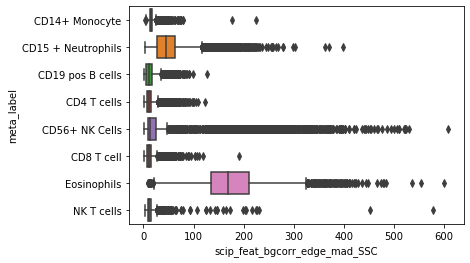

In [102]:
seaborn.boxplot(
    data=df_train,
    x=Xs.columns[s[-10:][::-1][0]],
    y="meta_label"
)

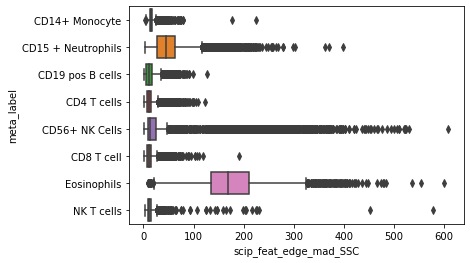

In [103]:
seaborn.boxplot(
    data=df_train,
    x=Xs.columns[s[-10:][::-1][1]],
    y="meta_label",
    hue_order=["mcp-_psba+", "mcp+_psba+", "mcp+_psba-", "mcp-_psba-"]
)

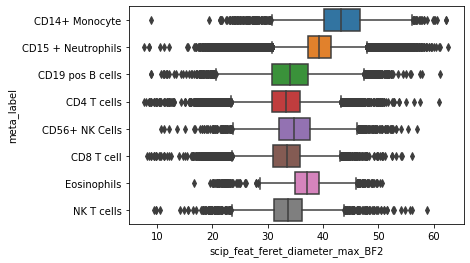

In [104]:
seaborn.boxplot(
    data=df_train,
    x=Xs.columns[s[-10:][::-1][7]],
    y="meta_label",
    hue_order=["mcp-_psba+", "mcp+_psba+", "mcp+_psba-", "mcp-_psba-"]
)

#### SHAP analysis to identify features explaining cell states

In [105]:
# we only look at events that were correctly predicted by the model
Xs_correct = Xs_test[preds == y_test]

In [106]:
numpy.random.seed(0)
explainer = shap.TreeExplainer(model)
shap_values = explainer(Xs_correct)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


To understand the SHAP algorithm, we first have to understand how a gradient boosting classifier works. In short, $N$ different decision trees are trained to predict a class from the input features. When a prediction needs to be made, each tree produces its prediction in the form of a vector containing negative and positive ones. In this setting, each output vector will contain 4 numbers (= amount of states) of which only one will be positive (= the state this decision tree thinks the input belongs to). The vectors from all the trees are then added using a weighted sum. This produces one vector containing for numbers. The class with the highest number is the one predicted by the gradient boosting model.

The SHAP algorithm then analyzes the trees in the gradient boosting model, and tries to attribute how much each feature with it's specific value contributed to the numbers that are output by the model. 

This way the SHAP analysis is similar to the feature importance above, but it gives us a much more detailed look into feature importances: for every value of every feature of every instance we get a particular importance score. 

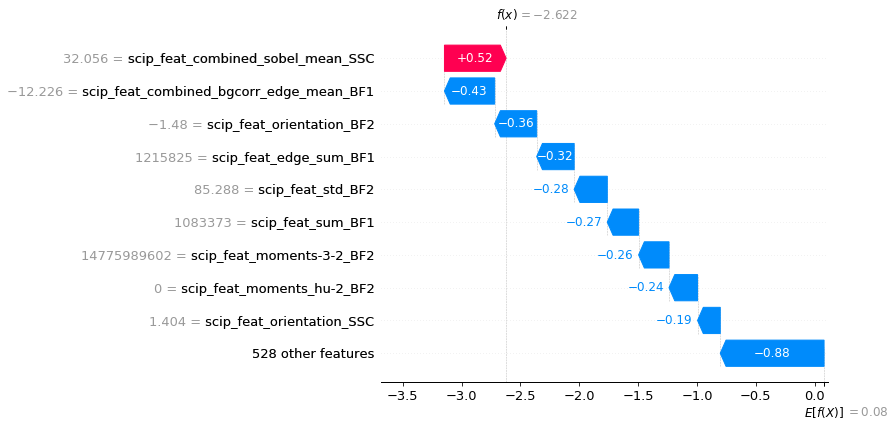

In [107]:
shap.plots.waterfall(shap_values[0, :, enc.transform(["Eosinophils"])[0]])

##### MCP-/PSBA+ events

Above, we saw an explanation for one event. Below, we see the beeswarm plot, which summarizes the contributions of the features for all events in the dataset. This is still for the MCP-/PSBA+ class. 

Each dot on the plot corresponds to one event. The color of the dot indicates the value of the feature for an event (low to high, blue to red). The rows are ordered according to average importance over the dataset. If a dot is to the left of the center-line, the feature contributes negatively to the event being classified in the MCP-/PSBA+ state. If it is on the right, it contributes positively (= making it more likely that an event would be classified as this state).

On the first row, we again find the MAD of the edge of cell in the BF channel. We can see that on average high values of this feature contribute positively to events being classified as MCP-/PSBA+. On the second row, we find the maximum value of the sobel map of the DAPI channel. The sobel map computes the gradient of neighbouring pixels in the image. A high maximum value of the sobel map means that the image contains a set of neighbouring pixels that have a large difference in intensity. If this feature is low, the neighbouring pixels are more uniform and don't change rapidly. Because the red dots are mainly to the left of the center line, we can derive that high values of this feature contribute negatively to an event being classified as MCP-/PSBA+. Events with a more uniform DAPI signal (= blue dots to the right of the center line) are more likely to be classified as MCP-/PSBA+ cells.

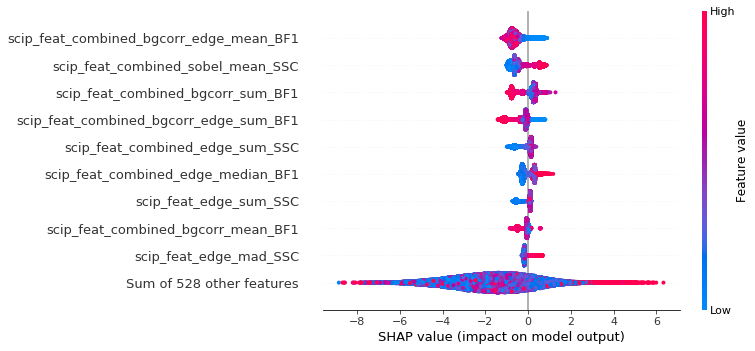

In [108]:
label = enc.transform(["Eosinophils"])[0]
shap.plots.beeswarm(shap_values[:, :, label])

A final new SHAP plot shown below, zooms in on one specific feature. It shows the feature's contribution to the prediction in function of the feature value. In the plot we look at the maximum sobel value in the DAPI channel. Each dot corresponds again to one event. This plot allows us to see patterns within the range of values that a feature can assume. 

On the X-axis we see the possible values of the feature in the dataset, and in gray the distribution of it. On the Y-axis, we see the contribution of the feature to the MCP-/PSBA+ state prediction. Ignoring the color of the dots for now, we can derive that as the maximum sobel value of the DAPI channel increases beyond approximately 150 the feature starts to contribute negatively to the MCP-/PSBA+ state. Events with a value less then 150 are thus more likely to be classified as MCP-/PSBA+.

A second aspect is the color. This color denotes the value of another feature, in this case kurtosis of the distribution of intensities in the DAPI channel. This feature interacts strongly with the maximum sobel value in the DAPI channel. For example, we can see that values that have a maximum sobel of less than 150 and a high kurtosis value have a smaller positive contribution towards MCP-/PSBA+ than the events with a low kurtosis value. So in biological terms this means that events with a uniform DAPI signal and a narrow distribution of DAPI intensities are more likely to be MCP-/PSBA+ events than those with a wide distribution of DAPI intensities. 

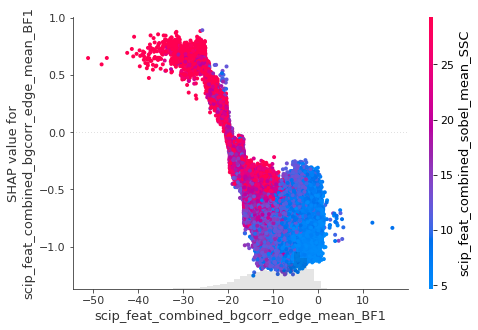

In [110]:
label = enc.transform(["Eosinophils"])[0]
shap.plots.scatter(shap_values[:, "scip_feat_combined_bgcorr_edge_mean_BF1", label], color=shap_values[:, :, label])

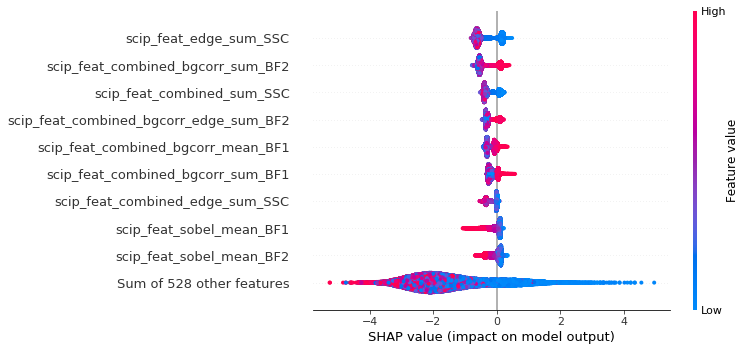

In [111]:
label = enc.transform(["CD8 T cell"])[0]
shap.plots.beeswarm(shap_values[:, :, label])

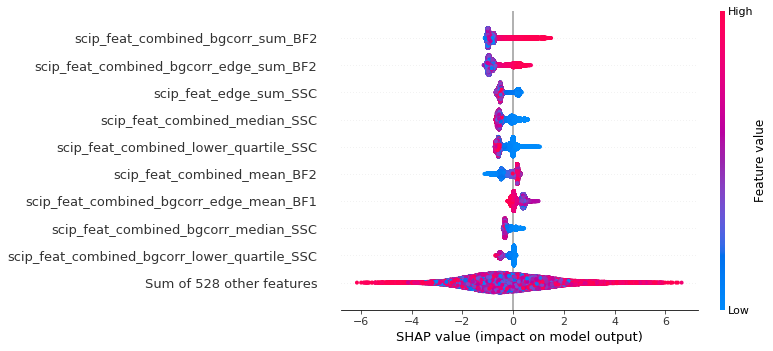

In [113]:
label = enc.transform(["CD4 T cells"])[0]
shap.plots.beeswarm(shap_values[:, :, label])